## CLIM670 Assignment #4
### Austin Reed

In [282]:
import numpy as np 
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import cartopy.feature as cfeature

### Assignment description: Make a plot of the difference between the annual mean for your experiment and the climatology experiment for precipitation and surface temperature over the continental US for each experiment. This will make 2 9-panel figures. One for preciptiation and one for surface temperature.



### Cristiana Experiment: Climatology (control)

In [283]:
f='/glade/derecho/scratch/cstan/archive/testatmF/atm/hist/*.nc'
DS_dwg_control=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_dwg_control

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 144, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1961-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(134, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(134, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(134, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF
    logname:           cstan
    host:              derecho4
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [306]:
control_precip_large_scale=DS_dwg_control['PRECL']*1000*86400 #converts m/s to mm/day

In [307]:
control_precip_convective=DS_dwg_control['PRECC']*1000*86400 #converts m/s to mm/day

In [286]:
control_precip_all_mean=(control_precip_large_scale+control_precip_convective).mean(dim='time')
control_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [287]:
control_temp_mean=DS_dwg_control['TS'].mean(dim='time')
control_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

### My experiment: Neutral Pacific, cold Atlantic

In [ ]:
f='/glade/derecho/scratch/areed/archive/testatmF2/atm/hist/*.nc'
DS_dwg_austin=xr.open_mfdataset(f,combine='nested',concat_dim='time')

In [176]:
#DS_dwg_austin

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF2
    logname:           areed
    host:              derecho6
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [177]:
austin_precip_large_scale=DS_dwg_austin['PRECL']*1000*86400 #converts m/s to mm/day

In [178]:
austin_precip_convective=DS_dwg_austin['PRECC']*1000*86400 #converts m/s to mm/day

In [294]:
austin_precip_all_mean=(austin_precip_large_scale+austin_precip_convective).mean(dim='time')
austin_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [295]:
austin_temp_mean=DS_dwg_austin['TS'].mean(dim='time')
austin_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [181]:
diff_austinminuscontrol_precip=(austin_precip_all_mean-control_precip_all_mean).compute()
diff_austinminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[-0.01903631, -0.01903663, -0.01903631, ..., -0.01903631,
        -0.01903662, -0.01903639],
       [-0.01852431, -0.01823119, -0.01768879, ..., -0.02034228,
        -0.01968746, -0.01907174],
       [-0.00959251, -0.00923416, -0.00910422, ..., -0.01166874,
        -0.01106507, -0.01052283],
       ...,
       [ 0.02434993,  0.0224193 ,  0.02044916, ...,  0.02605625,
         0.02560959,  0.02467515],
       [ 0.021297  ,  0.02358875,  0.02526251, ...,  0.01652914,
         0.01775548,  0.01935097],
       [ 0.0133646 ,  0.0134945 ,  0.01358812, ...,  0.01351962,
         0.01347122,  0.01340344]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

Text(0.5, 1.0, 'Precipitaiton difference (PnAc-Control)')

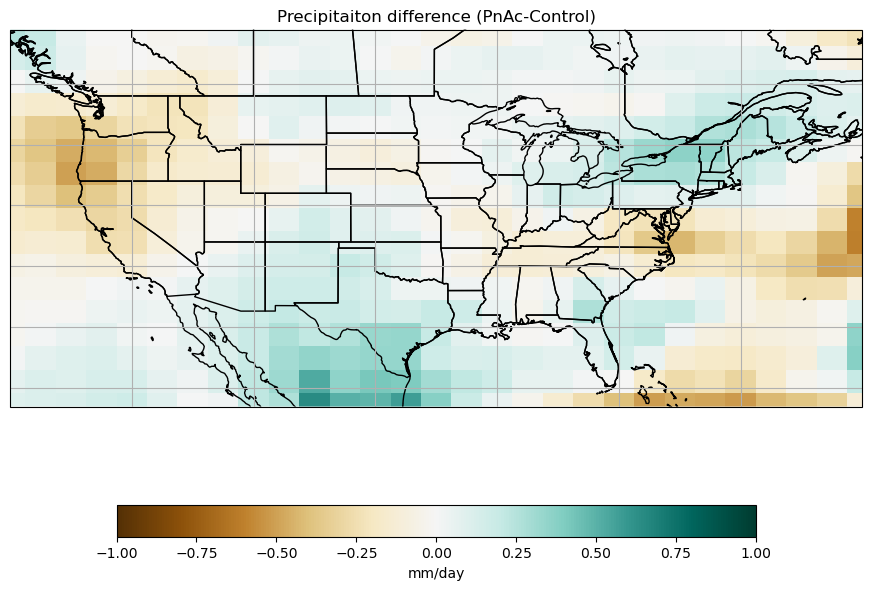

In [296]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_austinminuscontrol_precip,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='BrBG')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()
scale='10m'
states50 = cfeature.NaturalEarthFeature(
            category='cultural',
            name='admin_1_states_provinces_lines',
            scale=scale,
            facecolor='none',
            edgecolor='b')
#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='mm/day',orientation='horizontal')
plt.title('Precipitaiton difference (PnAc-Control)')

In [182]:
diff_austinminuscontrol_temp=(austin_temp_mean-control_temp_mean).compute()

Text(0.5, 1.0, 'Temperature difference (PnAc-Control)')

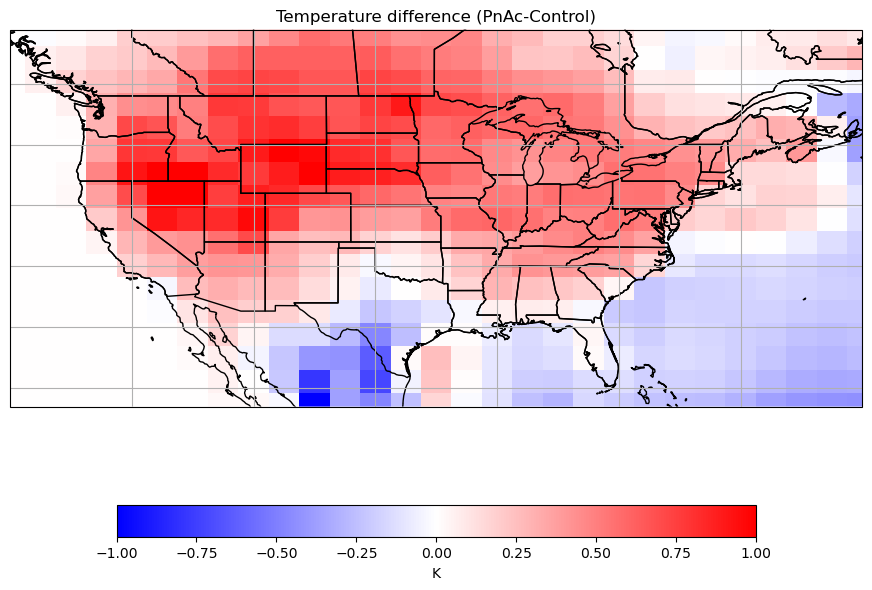

In [308]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_austinminuscontrol_temp,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='bwr')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()
#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='K',orientation='horizontal')
plt.title('Temperature difference (PnAc-Control)')

### Sany Experiment: Neutral Pacific, neutral Atlantic

In [298]:
f='/glade/derecho/scratch/tsany/archive/hw4_sany/atm/hist/*.nc'
DS_dwg_sany=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_dwg_sany

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              hw4_sany
    logname:           tsany
    host:              derecho4
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [309]:
sany_precip_large_scale=DS_dwg_sany['PRECL']*1000*86400 #converts m/s to mm/day

In [310]:
sany_precip_convective=DS_dwg_sany['PRECC']*1000*86400 #converts m/s to mm/day

In [301]:
sany_precip_all_mean=(sany_precip_large_scale+sany_precip_convective).mean(dim='time')
sany_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [302]:
sany_temp_mean=DS_dwg_sany['TS'].mean(dim='time')
sany_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [303]:
diff_sanyminuscontrol_precip=(sany_precip_all_mean-control_precip_all_mean).compute()
diff_sanyminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[-0.04779117, -0.04779667, -0.04779757, ..., -0.04778995,
        -0.04779013, -0.04779033],
       [-0.08212842, -0.08167457, -0.08061908, ..., -0.083354  ,
        -0.08290988, -0.08248695],
       [-0.08428466, -0.08272234, -0.08093101, ..., -0.09049498,
        -0.08837679, -0.08616659],
       ...,
       [ 0.10363207,  0.10123696,  0.09831473, ...,  0.10793281,
         0.10694719,  0.10477566],
       [ 0.09946462,  0.1009406 ,  0.10174336, ...,  0.0967537 ,
         0.09688355,  0.09807321],
       [ 0.05487577,  0.05495512,  0.05486726, ...,  0.05506483,
         0.05501512,  0.05495741]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

Text(0.5, 1.0, 'Precipitaiton difference (PnAn-Control)')

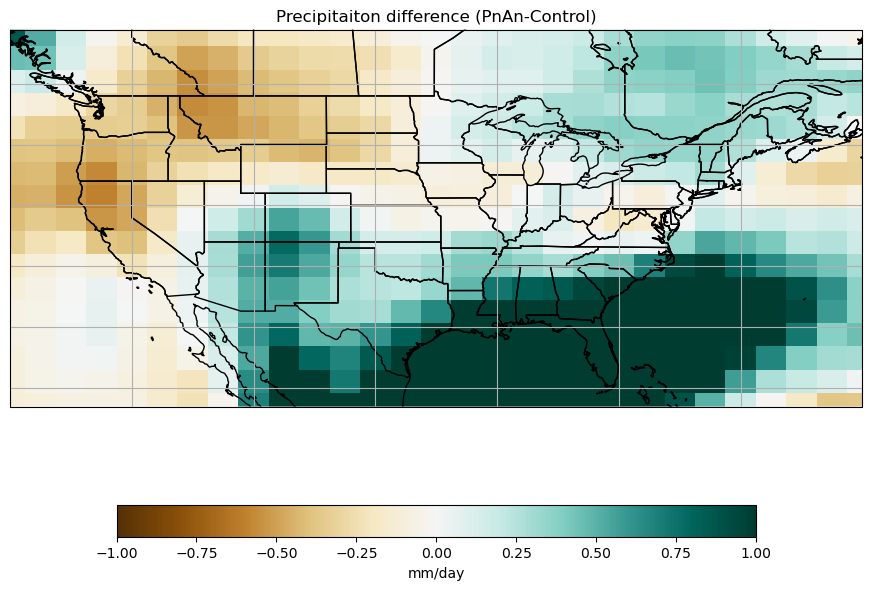

In [89]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_sanyminuscontrol_precip,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='BrBG')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()

#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='mm/day',orientation='horizontal')
plt.title('Precipitaiton difference (PnAn-Control)')

In [304]:
diff_sanyminuscontrol_temp=(sany_temp_mean-control_temp_mean).compute()

Text(0.5, 1.0, 'Temperature difference (PnAn-Control)')

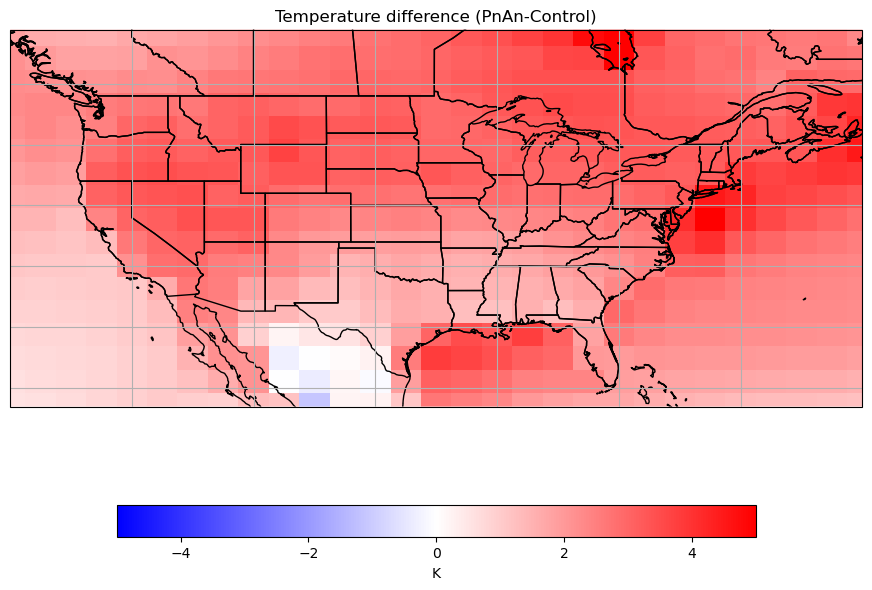

In [109]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_sanyminuscontrol_temp,vmin=-5.0,vmax=5.0,transform = ccrs.PlateCarree(),cmap='bwr')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()
#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='K',orientation='horizontal')
plt.title('Temperature difference (PnAn-Control)')

### Katherine Experiment: Neutral Pacific, warm Atlantic

In [ ]:
f='/glade/derecho/scratch/kbarragan/archive/testatmF/atm/hist/*.nc'
DS_dwg_katherine=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_dwg_katherine

In [192]:
katherine_precip_large_scale=DS_dwg_katherine['PRECL']*1000*86400 #converts m/s to mm/day

In [193]:
katherine_precip_convective=DS_dwg_katherine['PRECC']*1000*86400 #converts m/s to mm/day

In [195]:
katherine_precip_all_mean=(katherine_precip_large_scale+katherine_precip_convective).mean(dim='time')
katherine_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [196]:
katherine_temp_mean=DS_dwg_katherine['TS'].mean(dim='time')
katherine_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [197]:
diff_katherineminuscontrol_precip=(katherine_precip_all_mean-control_precip_all_mean).compute()
diff_katherineminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[ 5.02158205e-03,  5.01905966e-03,  5.01971691e-03, ...,
         5.02054441e-03,  5.02081355e-03,  5.02095366e-03],
       [-4.67423063e-03, -5.30672451e-03, -5.57797155e-03, ...,
        -3.10230273e-03, -3.47010366e-03, -4.11888050e-03],
       [-1.27669615e-02, -1.30300193e-02, -1.29853493e-02, ...,
        -1.22712298e-02, -1.25268374e-02, -1.29222905e-02],
       ...,
       [-5.03757333e-03, -7.28615202e-03, -8.27058197e-03, ...,
        -1.73748441e-04, -2.21470908e-03, -4.41975981e-03],
       [ 3.46669699e-05,  9.60234677e-04,  2.62371054e-03, ...,
        -4.14627073e-03, -2.83741166e-03, -7.96481479e-04],
       [ 4.74979201e-03,  4.85123215e-03,  4.73535038e-03, ...,
         4.80588208e-03,  4.77323146e-03,  4.72348039e-03]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

Text(0.5, 1.0, 'Precipitaiton difference (PnAw-Control)')

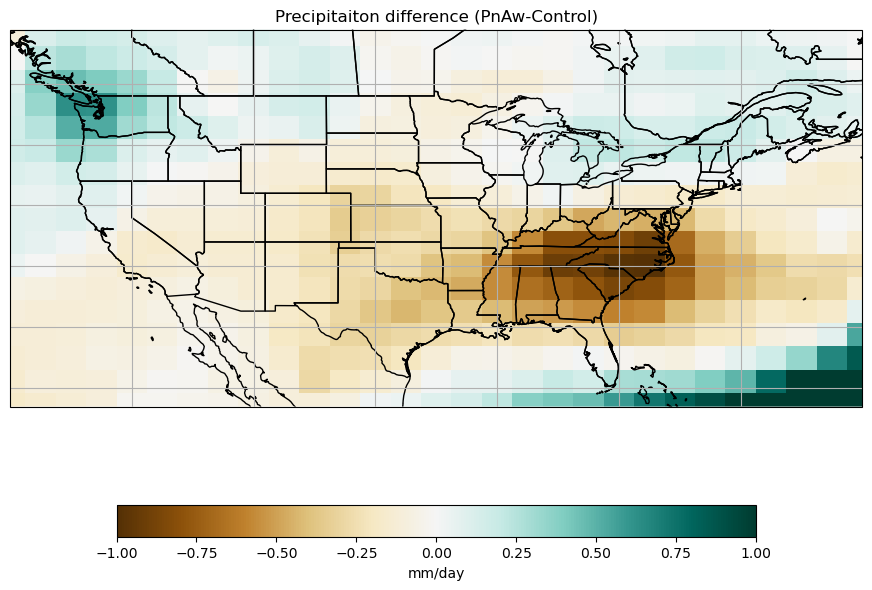

In [311]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_katherineminuscontrol_precip,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='BrBG')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()

#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='mm/day',orientation='horizontal')
plt.title('Precipitaiton difference (PnAw-Control)')

In [110]:
diff_katherineminuscontrol_temp=(katherine_temp_mean-control_temp_mean).compute()

Text(0.5, 1.0, 'Temperature difference (PnAw-Control)')

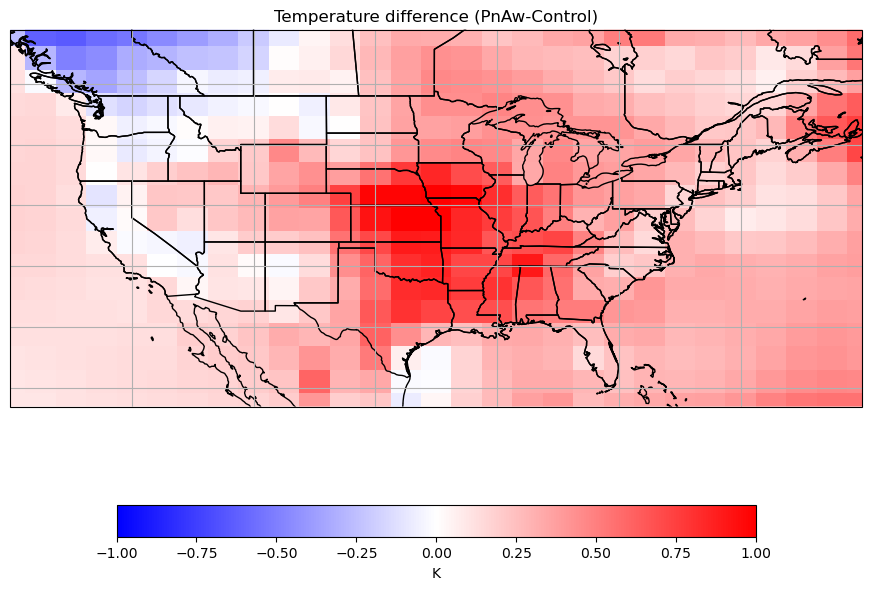

In [312]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_katherineminuscontrol_temp,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='bwr')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()
#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='K',orientation='horizontal')
plt.title('Temperature difference (PnAw-Control)')

### Aasma Experiment: Warm Pacific, neutral Atlantic

In [198]:
f='/glade/derecho/scratch/aacharia/archive/testatmF/atm/hist/*.nc'
DS_dwg_aashma=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_dwg_aashma

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF
    logname:           aacharia
    host:              derecho7
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [199]:
aashma_precip_large_scale=DS_dwg_aashma['PRECL']*1000*86400 #converts m/s to mm/day

In [200]:
aashma_precip_convective=DS_dwg_aashma['PRECC']*1000*86400 #converts m/s to mm/day

In [201]:
aashma_precip_all_mean=(aashma_precip_large_scale+aashma_precip_convective).mean(dim='time')
aashma_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [202]:
aashma_temp_mean=DS_dwg_aashma['TS'].mean(dim='time')
aashma_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [203]:
diff_aashmaminuscontrol_precip=(aashma_precip_all_mean-control_precip_all_mean).compute()
diff_aashmaminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[ 0.00438831,  0.00438789,  0.00438962, ...,  0.00438865,
         0.00438841,  0.00438795],
       [-0.01483965, -0.0147623 , -0.01461478, ..., -0.01585748,
        -0.01562613, -0.01519672],
       [-0.01322198, -0.01268196, -0.01214287, ..., -0.0169095 ,
        -0.01556033, -0.01432698],
       ...,
       [-0.01255459, -0.00943427, -0.00754984, ..., -0.02317665,
        -0.02162162, -0.0179896 ],
       [ 0.00069167,  0.00302255,  0.0045947 , ..., -0.00315781,
        -0.00236909, -0.00066959],
       [-0.02702292, -0.02695629, -0.02693988, ..., -0.02683034,
        -0.02686609, -0.0269577 ]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

Text(0.5, 1.0, 'Precipitaiton difference (PwAn-Control)')

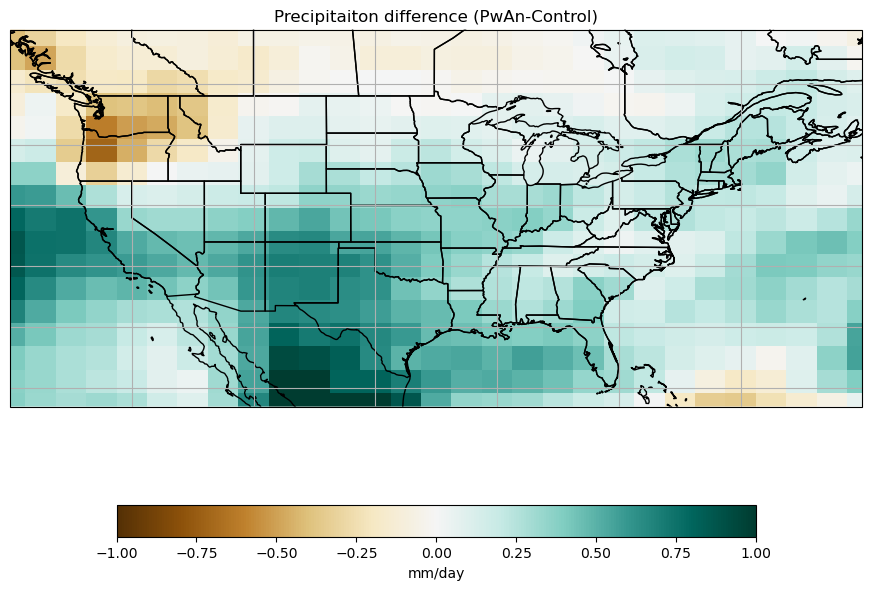

In [313]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_aashmaminuscontrol_precip,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='BrBG')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()

#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='mm/day',orientation='horizontal')
plt.title('Precipitaiton difference (PwAn-Control)')

In [120]:
diff_aashmaminuscontrol_temp=(aashma_temp_mean-control_temp_mean).compute()

Text(0.5, 1.0, 'Temperature difference (PwAn-Control)')

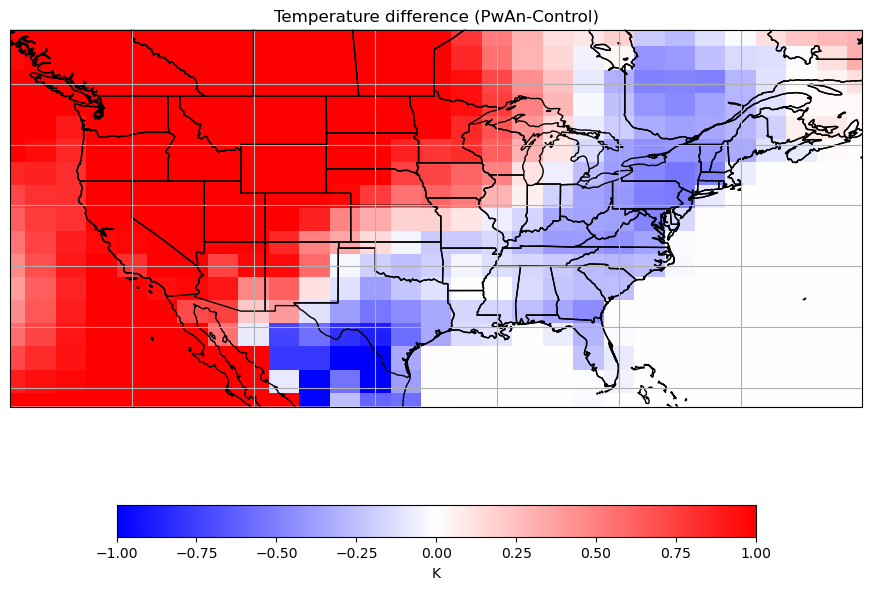

In [121]:
fig = plt.figure(figsize=(11,8.5))
ax=plt.axes(projection=ccrs.PlateCarree())
clevs=np.linspace(-1.0,1.0,20)
cs=ax.pcolormesh(diff_austinminuscontrol_precip['lon'], diff_austinminuscontrol_precip['lat'],diff_aashmaminuscontrol_temp,vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='bwr')
ax.set_extent([-130,-60,23.486,49])
ax.coastlines()
ax.gridlines()
#ax.add_feature(states50, linewidth=1.5)
ax.add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

#us_shapes = list(shpreader.Reader("/scratch/areed29/gadm36_USA_shp/gadm36_USA_1.shp"
#).geometries())
#ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
#                  facecolor='none')
cbar=plt.colorbar(cs, shrink=0.75,label='K',orientation='horizontal')
plt.title('Temperature difference (PwAn-Control)')

In [207]:
#Heidi experiment (PwAw):
f='/glade/derecho/scratch/hnsiah/archive/testatmF/atm/hist/*.nc'
DS_dwg_heidi=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_dwg_heidi

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF
    logname:           hnsiah
    host:              derecho4
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [208]:
heidi_precip_large_scale=DS_dwg_heidi['PRECL']*1000*86400 #converts m/s to mm/day

In [209]:
heidi_precip_convective=DS_dwg_heidi['PRECC']*1000*86400 #converts m/s to mm/day

In [210]:
heidi_precip_all_mean=(heidi_precip_large_scale+heidi_precip_convective).mean(dim='time')
heidi_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [211]:
heidi_temp_mean=DS_dwg_heidi['TS'].mean(dim='time')
heidi_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [212]:
diff_heidiminuscontrol_precip=(heidi_precip_all_mean-control_precip_all_mean).compute()
diff_heidiminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[ 0.00438831,  0.00438789,  0.00438962, ...,  0.00438865,
         0.00438841,  0.00438795],
       [-0.01483965, -0.0147623 , -0.01461478, ..., -0.01585748,
        -0.01562613, -0.01519672],
       [-0.01322198, -0.01268196, -0.01214287, ..., -0.0169095 ,
        -0.01556033, -0.01432698],
       ...,
       [-0.01255459, -0.00943427, -0.00754984, ..., -0.02317665,
        -0.02162162, -0.0179896 ],
       [ 0.00069167,  0.00302255,  0.0045947 , ..., -0.00315781,
        -0.00236909, -0.00066959],
       [-0.02702292, -0.02695629, -0.02693988, ..., -0.02683034,
        -0.02686609, -0.0269577 ]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [213]:
diff_heidiminuscontrol_temp=(heidi_temp_mean-control_temp_mean).compute()

In [214]:
#Jakub experiment (PcAn):
f='/glade/derecho/scratch/jstanczak/archive/dwg_pcan/atm/hist/*.nc'
DS_dwg_jakub=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_dwg_jakub

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              dwg_pcan
    logname:           jstanczak
    host:              derecho2
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [216]:
jakub_precip_large_scale=DS_dwg_jakub['PRECL']*1000*86400 #converts m/s to mm/day

In [217]:
jakub_precip_convective=DS_dwg_jakub['PRECC']*1000*86400 #converts m/s to mm/day

In [218]:
jakub_precip_all_mean=(jakub_precip_large_scale+jakub_precip_convective).mean(dim='time')
jakub_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [219]:
jakub_temp_mean=DS_dwg_jakub['TS'].mean(dim='time')
jakub_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [220]:
diff_jakubminuscontrol_precip=(jakub_precip_all_mean-control_precip_all_mean).compute()
diff_jakubminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[-0.00974394, -0.00974685, -0.00974683, ..., -0.00974366,
        -0.00974473, -0.00974486],
       [-0.0144332 , -0.01469109, -0.01470152, ..., -0.01426286,
        -0.01406159, -0.01419074],
       [-0.01277701, -0.01219306, -0.01224697, ..., -0.0164529 ,
        -0.01490978, -0.01360899],
       ...,
       [ 0.036791  ,  0.03344093,  0.02939032, ...,  0.04597948,
         0.04040215,  0.03748604],
       [ 0.03888063,  0.03759429,  0.03557012, ...,  0.04429755,
         0.04335401,  0.04100011],
       [ 0.02084228,  0.02097761,  0.02087757, ...,  0.02101935,
         0.02098318,  0.02087157]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [221]:
diff_jakubminuscontrol_temp=(jakub_temp_mean-control_temp_mean).compute()

In [ ]:
#Sara experiment:

In [270]:
f='/glade/derecho/scratch/salmadani/archive/PwAc/atm/hist/*.nc'
DS_sara_dwg=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_sara_dwg

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              PwAc
    logname:           salmadani
    host:              derecho7
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [272]:
sara_precip_large_scale=DS_sara_dwg['PRECL']*1000*86400 #converts m/s to mm/day

In [274]:
sara_precip_convective=DS_sara_dwg['PRECC']*1000*86400 #converts m/s to mm/day

In [275]:
sara_precip_all_mean=(sara_precip_large_scale+sara_precip_convective).mean(dim='time')
sara_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [277]:
sara_temp_mean=DS_sara_dwg['TS'].mean(dim='time')
sara_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [314]:
diff_saraminuscontrol_precip=(sara_precip_all_mean-control_precip_all_mean).compute()
diff_saraminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[ 0.00438831,  0.00438789,  0.00438962, ...,  0.00438865,
         0.00438841,  0.00438795],
       [-0.01483965, -0.0147623 , -0.01461478, ..., -0.01585748,
        -0.01562613, -0.01519672],
       [-0.01322198, -0.01268196, -0.01214287, ..., -0.0169095 ,
        -0.01556033, -0.01432698],
       ...,
       [-0.01255459, -0.00943427, -0.00754984, ..., -0.02317665,
        -0.02162162, -0.0179896 ],
       [ 0.00069167,  0.00302255,  0.0045947 , ..., -0.00315781,
        -0.00236909, -0.00066959],
       [-0.02702292, -0.02695629, -0.02693988, ..., -0.02683034,
        -0.02686609, -0.0269577 ]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [279]:
diff_saraminuscontrol_temp=(sara_temp_mean-control_temp_mean).compute()

In [ ]:
#Ivy experiment:

In [315]:
f='/glade/derecho/scratch/istemp/archive/testatmF/atm/hist/*.nc'
DS_ivy_dwg=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_ivy_dwg

/glade/u/apps/opt/conda/envs/npl-2024a/lib/python3.11/site-packages/xarray/core/indexing.py:1446: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/glade/u/apps/opt/conda/envs/npl-2024a/lib/python3.11/site-packages/xarray/core/indexing.py:1446: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.a

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 260, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1970-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(241, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(241, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(241, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF
    logname:           istemp
    host:              derecho4
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [327]:
DS_ivy_correct=DS_ivy_dwg.sel(time=slice(DS_ivy_dwg['time'][0],DS_ivy_dwg['time'][120]))
DS_ivy_correct

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 121, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-02-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF
    logname:           istemp
    host:              derecho4
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [328]:
ivy_precip_large_scale=DS_ivy_correct['PRECL']*1000*86400 #converts m/s to mm/day

In [329]:
ivy_precip_convective=DS_ivy_correct['PRECC']*1000*86400 #converts m/s to mm/day

In [330]:
ivy_precip_all_mean=(ivy_precip_large_scale+ivy_precip_convective).mean(dim='time')
ivy_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [331]:
ivy_temp_mean=DS_ivy_correct['TS'].mean(dim='time')
ivy_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [332]:
diff_ivyminuscontrol_precip=(ivy_precip_all_mean-control_precip_all_mean).compute()
diff_ivyminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[-0.05965405, -0.05965805, -0.05965858, ..., -0.05965321,
        -0.05965409, -0.05965346],
       [-0.08059633, -0.07995696, -0.07925203, ..., -0.08267431,
        -0.08179813, -0.08131854],
       [-0.07726566, -0.07613422, -0.07504546, ..., -0.0812564 ,
        -0.07953122, -0.0784454 ],
       ...,
       [ 0.07431454,  0.07416546,  0.07607025, ...,  0.08650546,
         0.08151135,  0.07693568],
       [ 0.06671953,  0.06889483,  0.07020026, ...,  0.06359994,
         0.06410596,  0.06523451],
       [ 0.04894173,  0.04902215,  0.04886012, ...,  0.04916062,
         0.04911805,  0.0490869 ]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [333]:
diff_ivyminuscontrol_temp=(ivy_temp_mean-control_temp_mean).compute()

In [ ]:
#Jaedyn experiment:

In [334]:
f='/glade/derecho/scratch/jaedynw/archive/testatmF/atm/hist/*.nc'
DS_jaedyn_dwg=xr.open_mfdataset(f,combine='nested',concat_dim='time')
DS_jaedyn_dwg

<xarray.Dataset>
Dimensions:           (lat: 96, lon: 144, time: 130, lev: 32, ilev: 33,
                       nbnd: 2, slat: 95, slon: 144)
Coordinates:
  * lat               (lat) float64 -90.0 -88.11 -86.21 ... 86.21 88.11 90.0
  * lon               (lon) float64 0.0 2.5 5.0 7.5 ... 350.0 352.5 355.0 357.5
  * lev               (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * ilev              (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * time              (time) object 1950-02-01 00:00:00 ... 1960-01-01 00:00:00
  * slat              (slat) float64 -89.05 -87.16 -85.26 ... 85.26 87.16 89.05
  * slon              (slon) float64 -1.25 1.25 3.75 6.25 ... 351.2 353.8 356.2
Dimensions without coordinates: nbnd
Data variables: (12/392)
    gw                (time, lat) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>
    hyam              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    hybm              (time, lev) float64 dask.array<chunksize=(1, 32), meta=np.ndarray>
    P0                (time) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    hyai              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    hybi              (time, ilev) float64 dask.array<chunksize=(1, 33), meta=np.ndarray>
    ...                ...
    soa_c2            (time, lev, lat, lon) float32 dask.array<chunksize=(1, 32, 96, 144), meta=np.ndarray>
    soa_c2DDF         (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    soa_c2SFWET       (time, lat, lon) float32 dask.array<chunksize=(1, 96, 144), meta=np.ndarray>
    w_stag            (time, slat) float64 dask.array<chunksize=(121, 95), meta=np.ndarray>
    US                (time, lev, slat, lon) float64 dask.array<chunksize=(121, 32, 95, 144), meta=np.ndarray>
    VS                (time, lev, lat, slon) float64 dask.array<chunksize=(121, 32, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              testatmF
    logname:           jaedynw
    host:              derecho7
    initial_file:      /glade/campaign/cesm/cesmdata/inputdata/cesm2_init/b.e...
    topography_file:   /glade/campaign/cesm/cesmdata/inputdata/atm/cam/topo/f...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [335]:
jaedyn_precip_large_scale=DS_jaedyn_dwg['PRECL']*1000*86400 #converts m/s to mm/day

In [336]:
jaedyn_precip_convective=DS_jaedyn_dwg['PRECC']*1000*86400 #converts m/s to mm/day

In [337]:
jaedyn_precip_all_mean=(jaedyn_precip_large_scale+jaedyn_precip_convective).mean(dim='time')
jaedyn_precip_all_mean

<xarray.DataArray (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float64, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [338]:
jaedyn_temp_mean=DS_jaedyn_dwg['TS'].mean(dim='time')
jaedyn_temp_mean

<xarray.DataArray 'TS' (lat: 96, lon: 144)>
dask.array<mean_agg-aggregate, shape=(96, 144), dtype=float32, chunksize=(96, 144), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [339]:
diff_jaedynminuscontrol_precip=(jaedyn_precip_all_mean-control_precip_all_mean).compute()
diff_jaedynminuscontrol_precip

<xarray.DataArray (lat: 96, lon: 144)>
array([[-0.04656079, -0.04656554, -0.04656654, ..., -0.04655953,
        -0.04656007, -0.0465602 ],
       [-0.07507809, -0.07503785, -0.0745169 , ..., -0.07510476,
        -0.07499538, -0.07500272],
       [-0.08171398, -0.08001415, -0.07904213, ..., -0.08641021,
        -0.08497129, -0.08324521],
       ...,
       [ 0.15912274,  0.15496121,  0.15076379, ...,  0.16691969,
         0.16534433,  0.16293773],
       [ 0.10205993,  0.10338302,  0.10439311, ...,  0.09805963,
         0.09817891,  0.10026778],
       [ 0.05405825,  0.05414937,  0.0540505 , ...,  0.0542703 ,
         0.05423693,  0.05414515]])
Coordinates:
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5

In [340]:
diff_jaedynminuscontrol_temp=(jaedyn_temp_mean-control_temp_mean).compute()

In [ ]:
#Next task, make panel plots side-by-side for Precipitation and Temperature for each experiment

In [342]:
precipdiff_all=[diff_austinminuscontrol_precip,diff_sanyminuscontrol_precip,diff_katherineminuscontrol_precip,diff_aashmaminuscontrol_precip,diff_heidiminuscontrol_precip,diff_jakubminuscontrol_precip,diff_saraminuscontrol_precip,diff_ivyminuscontrol_precip,diff_jaedynminuscontrol_precip]
tempdiff_all=[diff_austinminuscontrol_temp,diff_sanyminuscontrol_temp,diff_katherineminuscontrol_temp,diff_aashmaminuscontrol_temp,diff_heidiminuscontrol_temp,diff_jakubminuscontrol_temp,diff_saraminuscontrol_temp,diff_ivyminuscontrol_temp,diff_jaedynminuscontrol_temp]

In [341]:
labels_all=['PnAc','PnAn','PnAw','PwAn','PwAw','PcAn','PwAc','PcAc','PcAw']

Text(0.5, 0.98, 'Precipitation and Temperature Differences (Experiment-Control)')

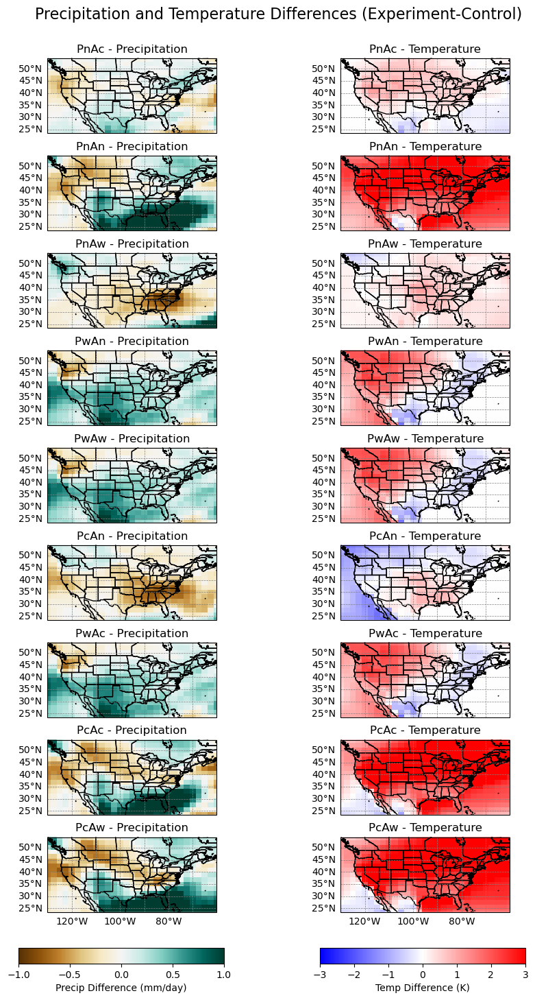

In [347]:
from cartopy.util import add_cyclic_point
import cartopy.mpl.ticker as cticker
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

# Create the figure and axes: 4 rows (locations) × 2 columns (precip/temp)
fig, axs = plt.subplots(nrows=9, ncols=2,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(20, 15))

# Loop through each location (row)
for i in range(9):
    # Precip plot (left)
    data_precip, lons = add_cyclic_point(precipdiff_all[i], coord=diff_austinminuscontrol_precip['lon'])
    cs = axs[i, 0].pcolormesh(lons, diff_austinminuscontrol_precip['lat'], data_precip, 
                              vmin=-1.0,vmax=1.0,transform = ccrs.PlateCarree(),cmap='BrBG')
    axs[i, 0].set_title(f'{labels_all[i]} - Precipitation')
    axs[i, 0].coastlines()
    axs[i,0].set_extent([-130,-60,23.486,49])
    gl=axs[i,0].gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=1.0, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    # Only label bottom row for longitude
    gl.bottom_labels = (i == 8)
    axs[i,0].add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')
    # Temp plot (right)
    data_temp, _ = add_cyclic_point(tempdiff_all[i], coord=diff_austinminuscontrol_precip['lon'])
    ct = axs[i, 1].pcolormesh(lons, diff_austinminuscontrol_precip['lat'], data_temp, 
                              vmin=-3.0,vmax=3.0,transform = ccrs.PlateCarree(),cmap='bwr')
    
    axs[i, 1].set_title(f'{labels_all[i]} - Temperature')
    axs[i, 1].coastlines()
    axs[i,1].set_extent([-130,-60,23.486,49])
    gl=axs[i,1].gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=1.0, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    # Only label bottom row for longitude
    gl.bottom_labels = (i == 8)
    
    axs[i,1].add_feature(cfeature.STATES, zorder=1, linewidth=1.0, edgecolor='black')

# Adjust subplot spacing
fig.subplots_adjust(bottom=0.1, top=0.93, left=0.3, right=0.70,
                    wspace=0.15, hspace=0.3)

# Colorbars
cbar_ax1 = fig.add_axes([0.31, 0.05, 0.15, 0.015])  # for precip
fig.colorbar(cs, cax=cbar_ax1, orientation='horizontal', label='Precip Difference (mm/day)')

cbar_ax2 = fig.add_axes([0.53, 0.05, 0.15, 0.015])  # for temp
fig.colorbar(ct, cax=cbar_ax2, orientation='horizontal', label='Temp Difference (K)')

# Main title
plt.suptitle('Precipitation and Temperature Differences (Experiment-Control)', fontsize=16)